# Base Models

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pymc3 as pm

import altair as alt
import arviz as az
alt.data_transformers.disable_max_rows()

def destandardize_area(area_s):
    return area_s*np.std(d["living_space"]) + d["living_space"].mean()

def destandardize_price(price_s):
    return price_s * 100000

/home/corrie/.pyenv/versions/anaconda3-2019.03/lib/python3.7/site-packages/xarray/core/merge.py:17: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  PANDAS_TYPES = (pd.Series, pd.DataFrame, pd.Panel)


In [2]:
def draw_model_plot(sample, draws=50, title=""):
    draws = np.random.choice(len(sample["alpha"]), replace=False, size=draws)
    alpha = sample["alpha"][draws]
    beta = sample["beta"][draws]

    mu = alpha + beta*area_s[:, np.newaxis]
      
    fig, ax = plt.subplots(figsize=(13, 13))
    ax.plot(destandardize_area(area_s), destandardize_price(mu), c="gray", alpha=0.5)
    ax.set_xlabel("Living Area (in sqm)")
    ax.set_ylabel("Price (in €)")
    ax.set_title(title, fontdict={'fontsize': 30})
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
    return fig, ax

In [3]:
d = pd.read_csv("../data/interim_data/houses.csv", dtype = {"ags": str, "plz": str}, index_col=0)

In [4]:
d.drop(columns=["lat", "lng"]).head()

,ags,zip,price,price_s,log_price,log_price_s,sqm_price,log_sqm_price,log_sqm_price_s,living_space,living_space_s,sale_year,sale_month,const_year,const_year_s,objecttype,housetype,usage,interior_qual
3,11000000001000000094,12489,180000.0,1.800,12.100712,-0.814839,2246.069379,7.716937,-1.009445,80.14,-0.276690,2018,8,1936.0,-1.210219,flat,NaN,rent_out,normal
4,11000000001000000094,12489,87000.0,0.870,11.373663,-2.045434,1740.000000,7.461640,-1.700113,50.00,-0.671528,2017,7,1910.0,-1.913696,flat,NaN,rent_out,NaN
6,11000000001000000140,12489,101200.0,1.012,11.524854,-1.789530,3066.666667,8.028346,-0.166971,33.00,-0.894229,2016,4,2016.0,0.954326,flat,NaN,rent_out,NaN
9,11000000001000000140,12489,148400.0,1.484,11.907667,-1.141586,3420.142890,8.137438,0.128159,43.39,-0.758119,2017,1,2017.0,0.981383,flat,NaN,rent_out,sophisticated
10,11000000001000000140,12489,261200.0,2.612,12.473042,-0.184638,3374.677003,8.124055,0.091954,77.40,-0.312584,2016,6,2016.0,0.954326,flat,NaN,rent_out,sophisticated


In [5]:
d.shape

(8014, 21)

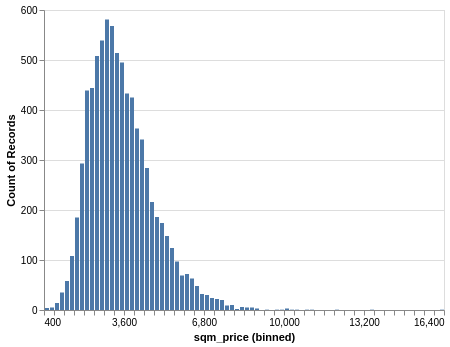

In [6]:
alt.Chart(d).mark_bar().encode(
    alt.X("sqm_price:Q", 
            bin=alt.BinParams(maxbins=100)),
    y="count()"
)

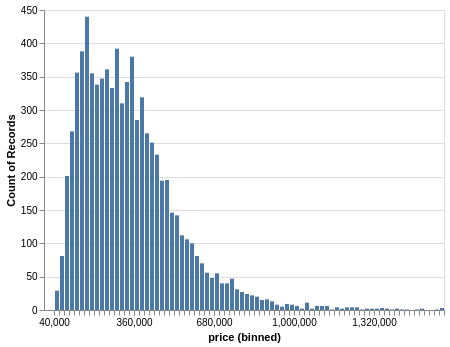

In [7]:
alt.Chart(d[d.price <= 1600000]).mark_bar().encode(
    alt.X("price:Q",
         bin = alt.BinParams(maxbins=100),
         scale = alt.Scale(domain=(0, 1600000)) ),
    y="count()"
)

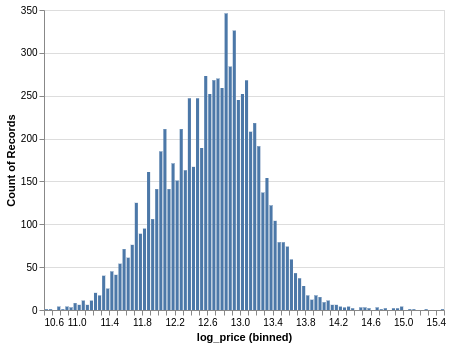

In [8]:
alt.Chart(d).mark_bar().encode(
    alt.X("log_price:Q",
         bin=alt.BinParams(maxbins=100)),
    y="count()"
)

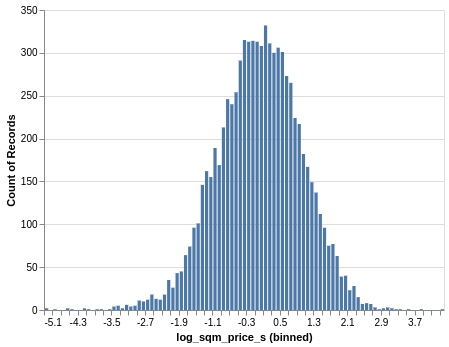

In [9]:
alt.Chart(d).mark_bar().encode(
    alt.X("log_sqm_price_s:Q", 
            bin=alt.BinParams(maxbins=100)),
    y="count()"
)

## Intercept only model

$$\begin{align*}
price &\sim \text{Normal}(\mu, \sigma)\\
\mu &\sim \text{Normal}(0, 10)\\
\sigma &\sim \text{HalfCauchy}(10)
\end{align*}$$

In [10]:
target = "price_s"

In [11]:
with pm.Model() as intercept_normal:
    mu = pm.Normal("mu", mu=0, sd=10)
    sigma = pm.HalfNormal("sigma", sd=10)
    
    y = pm.Normal("y", mu=mu, sd=sigma, observed = d[target])
    
    trace = pm.sample(random_seed=2405, chains=4)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 2 jobs)
NUTS: [sigma, mu]
Sampling 4 chains: 100%|██████████| 4000/4000 [00:03<00:00, 1151.10draws/s]
The acceptance probability does not match the target. It is 0.8859332495247249, but should be close to 0.8. Try to increase the number of tuning steps.


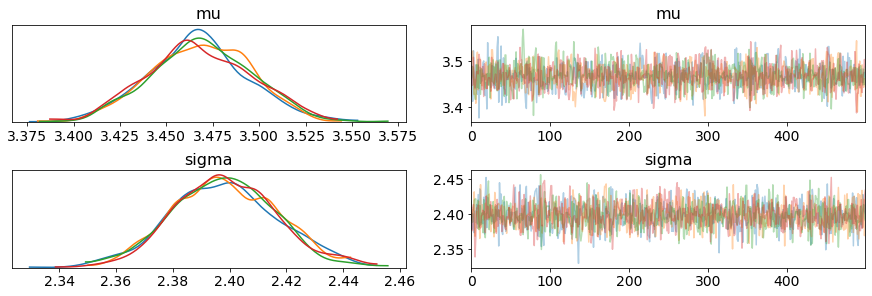

In [12]:
az.plot_trace(trace)
plt.show()

In [13]:
with pm.Model() as intercept_student:
    mu = pm.Normal("mu", mu=0, sd=20)
    sigma = pm.HalfCauchy("sigma", 10)
    nu = pm.Gamma("nu", alpha=2, beta=0.1)
    
    y = pm.StudentT("y", mu=mu, sd=sigma, nu=nu, observed=d[target])
    
    trace = pm.sample(random_seed=2405, chains=4)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 2 jobs)
NUTS: [nu, sigma, mu]
Sampling 4 chains: 100%|██████████| 4000/4000 [00:08<00:00, 477.78draws/s]


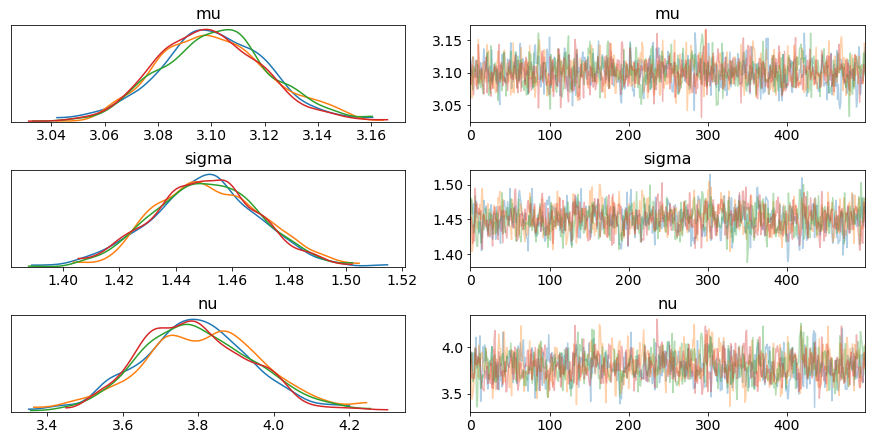

In [14]:
az.plot_trace(trace)
plt.show()

## Linear base model

$$\begin{align*}
price &\sim \text{Normal}(\mu, \sigma)\\
\mu &= \alpha + \beta \;\text{living_space}\\
\alpha &\sim \text{Normal}(0, 10) \\
\beta &\sim \text{Normal}(0, 1) \\
\sigma &\sim \text{HalfCauchy}(10)
\end{align*}$$

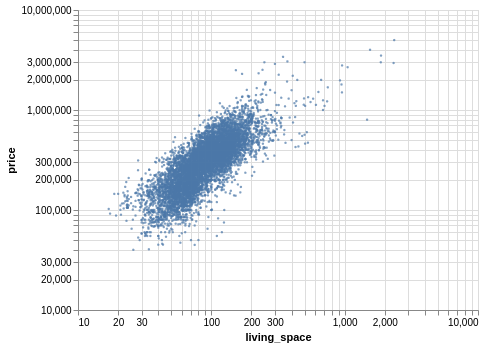

In [15]:
alt.Chart(d[d.living_space > 0]).mark_circle(clip=True,
                        opacity=0.7,
                        size=5).encode(
    x = alt.X("living_space", scale=alt.Scale(type="log")),
    y = alt.Y("price", scale=alt.Scale( type="log"))
)

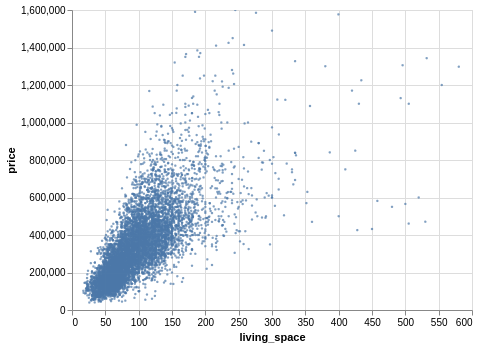

In [16]:
alt.Chart(d[d.living_space > 0]).mark_circle(clip=True,
                        opacity=0.7,
                        size=5).encode(
    x = alt.X("living_space",
             scale=alt.Scale(domain=(0, 600))),
    y = alt.Y("price", 
             scale=alt.Scale(domain=(0, 1500000)))
)

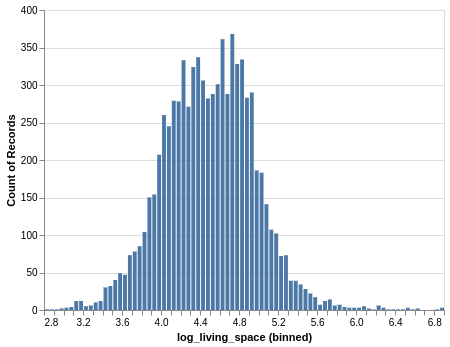

In [17]:
alt.Chart(d[d.living_space < 1000]).mark_bar().encode(
    alt.X("log_living_space:Q", 
            bin=alt.BinParams(maxbins=100)),
    y="count()"
).transform_calculate(
    log_living_space = "log(datum.living_space)"
)

In [18]:
with pm.Model() as lin_normal:
    alpha = pm.Normal("alpha", mu=0, sd=10)
    beta = pm.Normal("beta", mu=0, sd=1)
    mu = alpha + beta*d["living_space_s"]
    
    sigma = pm.HalfCauchy("sigma", 5)
    y = pm.Normal("y", mu=mu, sd=sigma, observed=d[target])
    trace = pm.sample(random_seed=2405, chains=4)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 2 jobs)
NUTS: [sigma, beta, alpha]
Sampling 4 chains: 100%|██████████| 4000/4000 [00:05<00:00, 732.36draws/s]


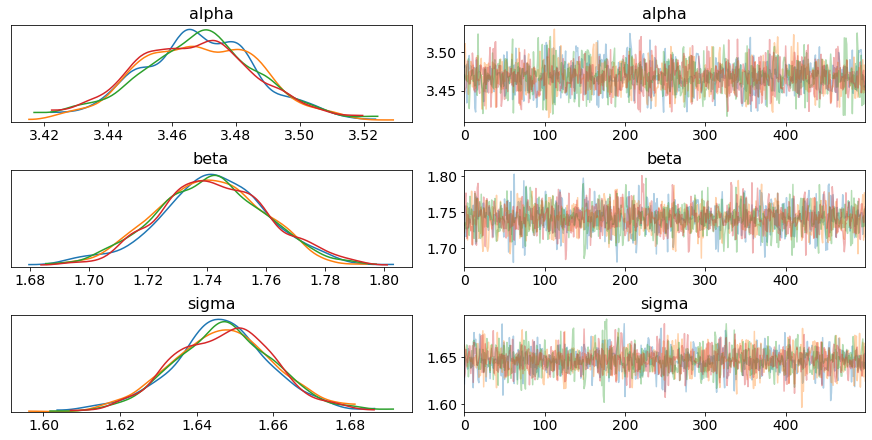

In [19]:
az.plot_trace(trace)
plt.show()

In [20]:
with pm.Model() as lin_student:
    alpha = pm.Normal("alpha", mu=0, sd=10)
    beta = pm.Normal("beta", mu=0, sd=1)
    mu = alpha + beta*d["living_space_s"]
    
    sigma = pm.HalfCauchy("sigma", 5)
    nu = pm.Gamma("nu", alpha=2, beta=0.1)
    y = pm.StudentT("y", nu=nu, mu=mu, sd=sigma, observed=d[target])
    trace = pm.sample(random_seed=2405, chains=4)
    
    prior = pm.sample_prior_predictive()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 2 jobs)
NUTS: [nu, sigma, beta, alpha]
Sampling 4 chains: 100%|██████████| 4000/4000 [00:17<00:00, 233.19draws/s]
The acceptance probability does not match the target. It is 0.881119253996933, but should be close to 0.8. Try to increase the number of tuning steps.


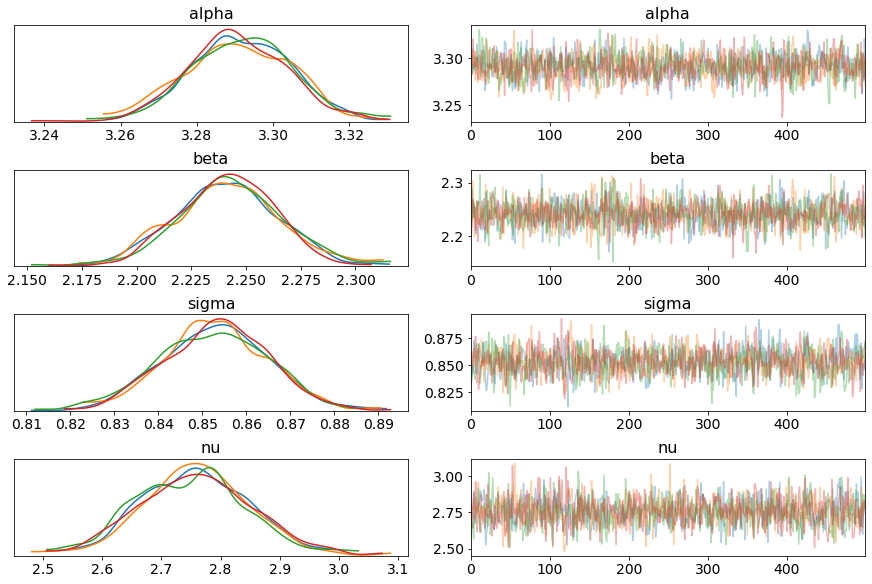

In [21]:
az.plot_trace(trace)
plt.show()

# Prior Predictive Checks

## Flat priors
Idea: have uninformative priors and thus be more objective/less subjective

In [22]:
with pm.Model() as flat_prior:
    alpha = pm.Normal("alpha", mu=0, sd=1000)
    beta = pm.Normal("beta", mu=0, sd=1000)
    mu = alpha + beta*d["living_space_s"]
    
    sigma = pm.HalfCauchy("sigma", 5)
    nu = pm.Gamma("nu", alpha=2, beta=0.1)
    y = pm.StudentT("y", nu=nu, mu=mu, sd=sigma, observed=d[target])
    
    flat_prior = pm.sample_prior_predictive()

In [23]:
with pm.Model() as less_flat_prior:
    alpha = pm.Normal("alpha", mu=0, sd=100)
    beta = pm.Normal("beta", mu=0, sd=100)
    mu = alpha + beta*d["living_space_s"]
    
    sigma = pm.HalfCauchy("sigma", 5)
    nu = pm.Gamma("nu", alpha=2, beta=0.1)
    y = pm.StudentT("y", nu=nu, mu=mu, sd=sigma, observed=d[target])
    
    less_flat_prior = pm.sample_prior_predictive()

In [24]:
flat_data = az.from_pymc3( prior = flat_prior )
less_flat_data = az.from_pymc3( prior = less_flat_prior )

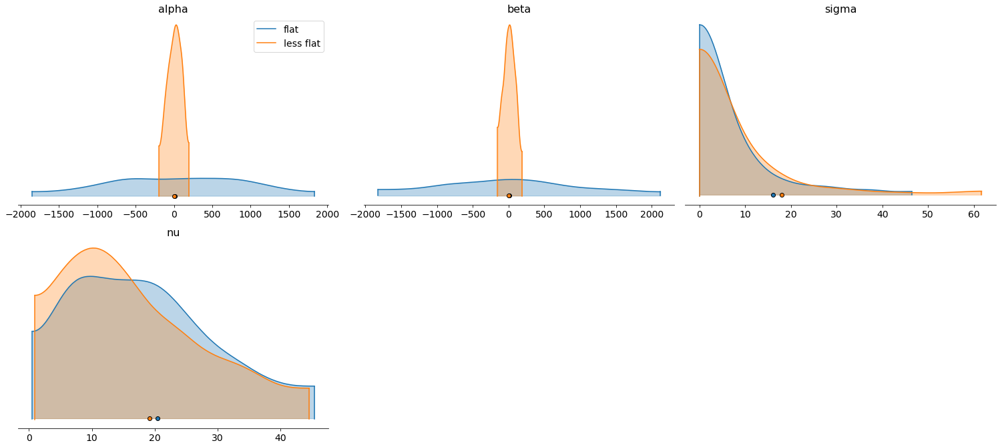

In [25]:
az.plot_density([flat_data, less_flat_data], group="prior",
                data_labels = ["flat", "less flat"],
               var_names = ["alpha", "beta", "sigma", "nu"],
               shade=0.3, bw=8,)
plt.show()

In [26]:
area_s = np.linspace(start=-1.5, stop=3, num=50)

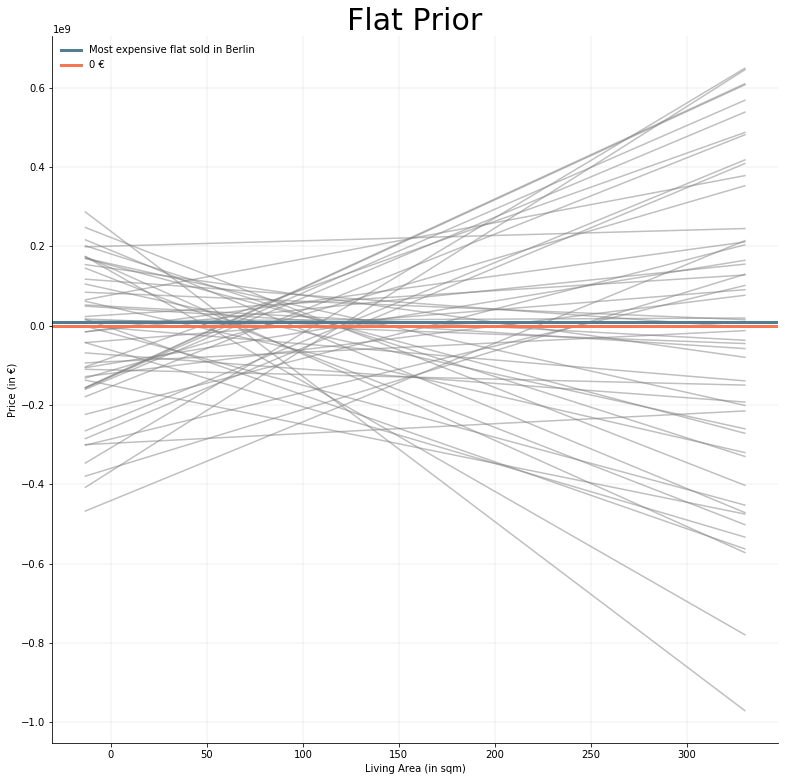

In [27]:
fig, ax = draw_model_plot(flat_prior, title="Flat Prior")
ax.axhline(y=8.5e6, c="#537d91", label="Most expensive flat sold in Berlin", lw=3)
ax.axhline(y=0, c="#f77754", label="0 €", lw=3)
ax.legend(frameon=False)
plt.show()

## Weakly informative prior

On recommendations what prior is recommended for the different parameters including what are good default parameter values, check [Prior recommendation by Stan team](https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations)

In [28]:
with pm.Model() as weakly_inf_prior:
    alpha = pm.Normal("alpha", mu=0, sd=20)
    beta = pm.Normal("beta", mu=0, sd=5)
    mu = alpha + beta*d["living_space_s"]
    
    sigma = pm.Exponential("sigma", lam = 1/2.5)
    nu = pm.Gamma("nu", alpha=2, beta=0.1)
    y = pm.StudentT("y", nu=nu, mu=mu, sd=sigma, observed=d[target])
    
    weakly_inf_prior = pm.sample_prior_predictive()

In [29]:
weakly_inf_data = az.from_pymc3(prior=weakly_inf_prior)

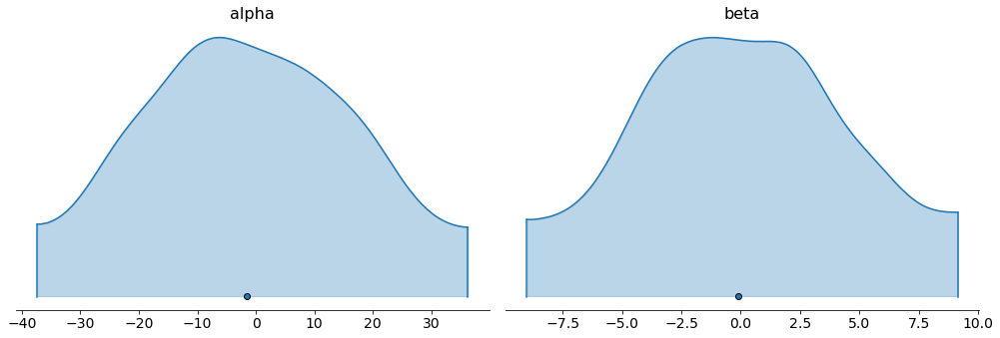

In [30]:
az.plot_density(weakly_inf_data, group="prior",
                data_labels = ["weakly informative prior"],
               var_names = ["alpha", "beta"],
               shade=0.3, bw=8,)
plt.show()

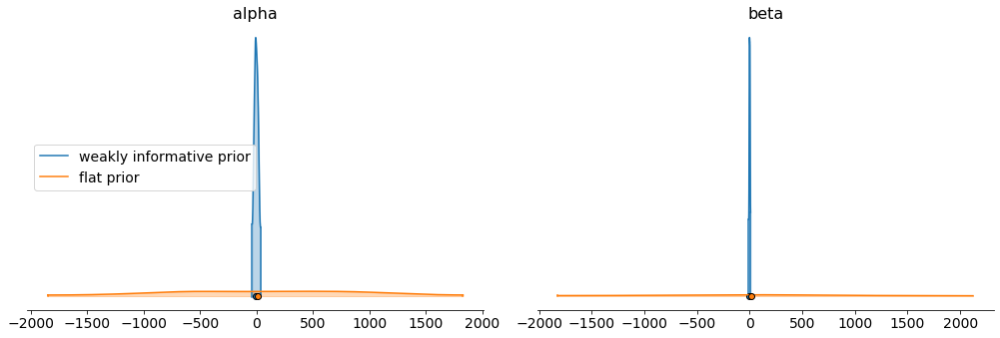

In [31]:
az.plot_density([weakly_inf_data, flat_data], group="prior",
                data_labels = ["weakly informative prior", "flat prior"],
               var_names = ["alpha", "beta"],
               shade=0.3, bw=8,)
plt.show()

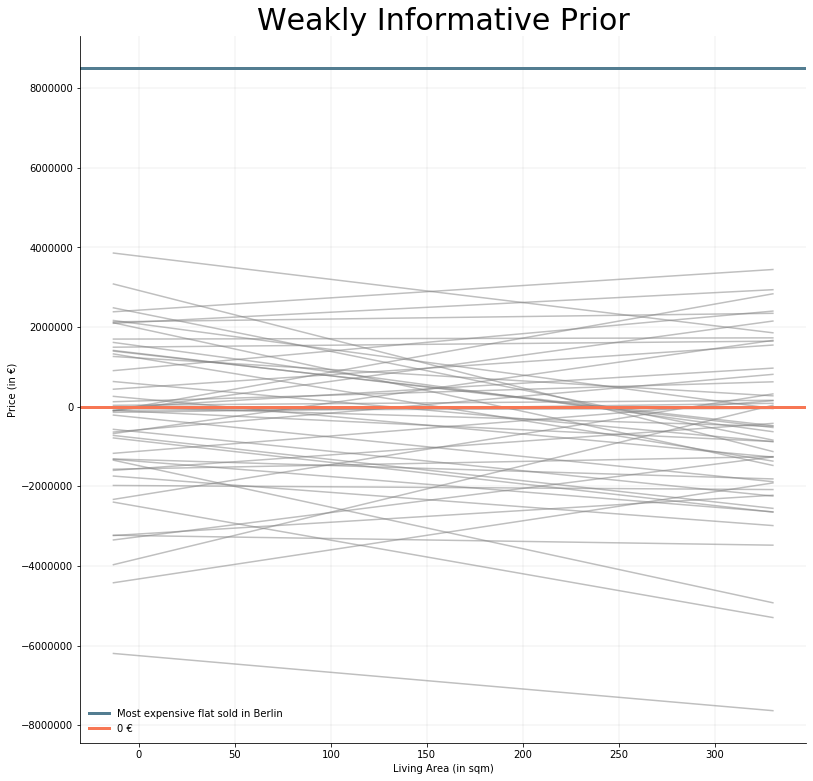

In [32]:
fig, ax = draw_model_plot(weakly_inf_prior, title="Weakly Informative Prior")
ax.axhline(y=8.5e6, c="#537d91", label="Most expensive flat sold in Berlin", lw=3)
ax.axhline(y=0, c="#f77754", label="0 €", lw=3)
ax.legend(frameon=False)
plt.show()

In [33]:
with pm.Model() as inf_prior:
    alpha = pm.Normal("alpha", mu=3, sd=2.5)
    beta = pm.Normal("beta", mu=1, sd=2.5)
    mu = alpha + beta*d["living_space_s"]
    
    sigma = pm.Exponential("sigma", lam = 1/2.5)
    nu = pm.Gamma("nu", alpha=2, beta=0.1)
    y = pm.StudentT("y", nu=nu, mu=mu, sd=sigma, observed=d[target])
    
    inf_prior = pm.sample_prior_predictive()

In [34]:
inf_data = az.from_pymc3(prior=inf_prior)

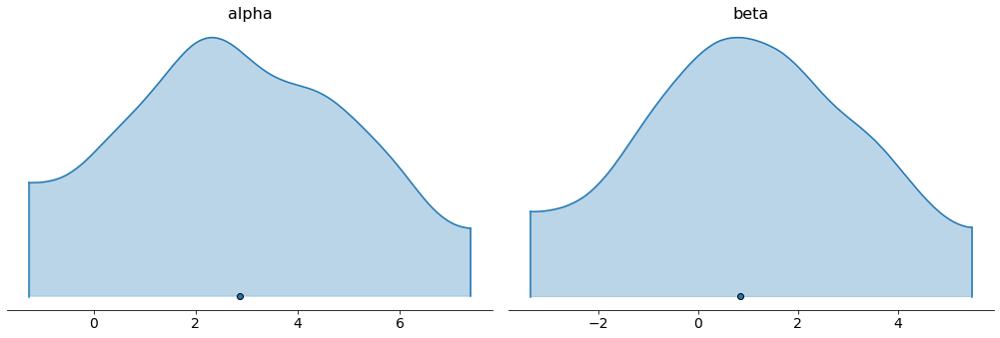

In [35]:
az.plot_density(inf_data, group="prior",
                data_labels = ["informative prior"],
               var_names = ["alpha", "beta"],
               shade=0.3, bw=8,)
plt.show()

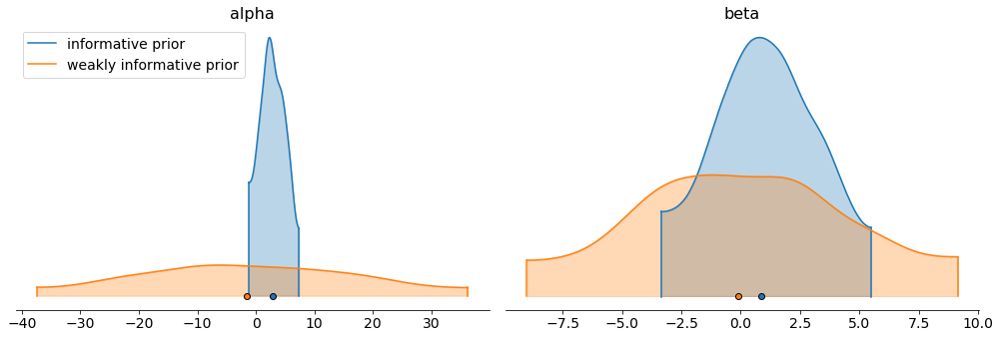

In [36]:
az.plot_density([inf_data, weakly_inf_data], group="prior",
                data_labels = ["informative prior", "weakly informative prior"],
               var_names = ["alpha", "beta"],
               shade=0.3, bw=8,)
plt.show()

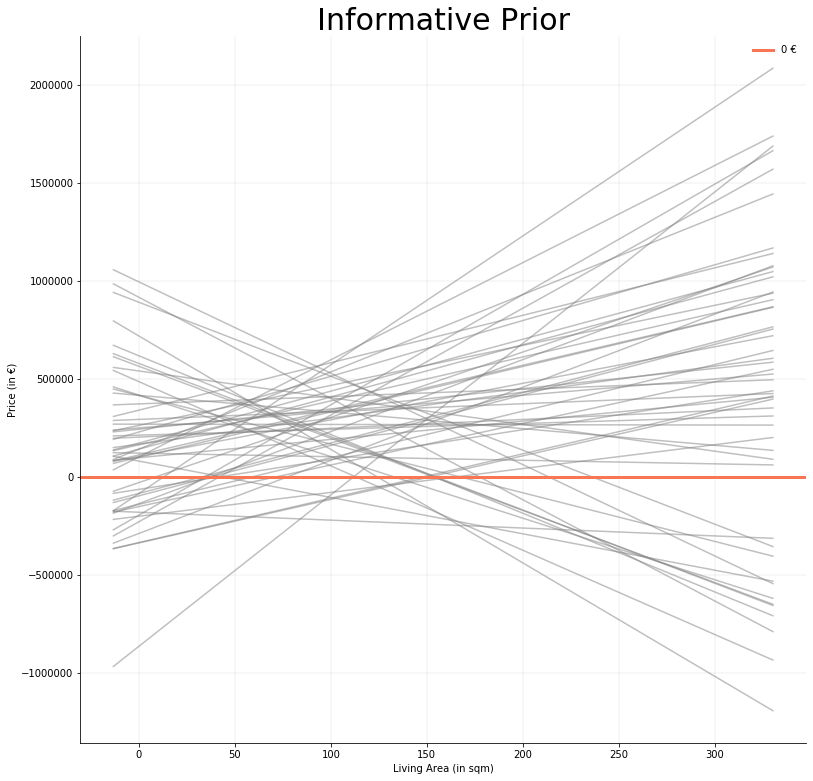

In [37]:
fig, ax = draw_model_plot(inf_prior, title="Informative Prior")
ax.axhline(y=0, c="#f77754", label="0 €", lw=3)
ax.legend(frameon=False)
plt.show()